In [1]:
# Parameters
current_time = "20_3_2022__21_32_54"
batch_id = 3
source_data = ".//data//source//Grocery, Fruits and Dry Fruits.csv"
source_notebook = ".//notebooks//input//Grocery_Data_Preprocessing.ipynb"
preprocessed_data = ".//data//processed//20_3_2022__21_32_54_Grocery, Fruits and Dry Fruits.csv"
unprocessed_data = ".//data//unprocessed//20_3_2022__21_32_54_unprocessed_Grocery, Fruits and Dry Fruits.csv"


# Reading the data into python

In [2]:
# Supressing the warning messages
import warnings
warnings.filterwarnings('ignore')

In [3]:
# Reading the dataset
import pandas as pd
import numpy as np


inventory_df = pd.read_csv(open(source_data))
inventory_df.sample(5)

,Category,Sub Category,Simplified Category,Brand Name,Product Name,Weight,MRP/Unit,Product ID,Image URL,Rating,No of Users Purchased
5573,Bakery Cakes Dairy,Bakery Snacks,Groceries,Bon & Bread,Herb Garlic Toast,200 g,145.0,202217574.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.4,56
4909,Gourmet World Food,Snacks Dry Fruits Nuts,Groceries,Epigamia,"Greek Yogurt - Wild, Raspberry",6x90 g Multipack,300.0,202216910.0,https://www.bigbasket.com/media/uploads/p/s/12...,4.2,50
9377,Kitchen Garden Pets,Gardening,Groceries,Klassic,"Polka Stripe - Railing Metal Pot Planter, Yell...",1 pc,259.0,202221378.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.2,37
7868,Snacks Branded Foods,Indian Mithai,Groceries,Haldirams,Soan Treat - Orange,250 g Pouch,65.0,202219869.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.4,72
3266,Beverages,Energy Soft Drinks,Groceries,Fanta,Soft Drink - Orange Flavoured,750 ml PET Bottle,40.0,202215267.0,https://www.bigbasket.com/media/uploads/p/s/25...,4.5,60


In [4]:
print('Shape before deleting duplicate values:', inventory_df.shape)

# Removing duplicate rows if any
inventory_df = inventory_df.drop_duplicates()
print('Shape After deleting duplicate values:', inventory_df.shape)

# Printing sample data
inventory_df.sample(5)

Shape before deleting duplicate values: (17609, 11)
Shape After deleting duplicate values: (17609, 11)


,Category,Sub Category,Simplified Category,Brand Name,Product Name,Weight,MRP/Unit,Product ID,Image URL,Rating,No of Users Purchased
7946,Cleaning Household,Party Festive Needs,Groceries,Clean Planet,Multipurpose Cotton Leafy Printed Regular Groc...,2 pcs,249.0,202219947.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.2,43
6269,Kitchen Garden Pets,Appliances Electricals,Groceries,Energizer,Alkaline Power AA BP4 Batteries - Long Lasting...,4 pcs,180.0,202218270.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.1,62
9582,Cleaning Household,Pooja Needs,Groceries,Asthagandha,Powder - Sandal,40 g,30.0,202221583.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.9,72
13821,Snacks Branded Foods,Pickles Chutney,Groceries,Priya,Pickle - Tomato (Without Garlic),300 g Bottle,99.0,202225822.0,https://www.bigbasket.com/media/uploads/p/s/26...,4.7,44
3332,Foodgrains Oil Masala,Rice Rice Products,Groceries,BB Royal,Rice - Dudheswar,5 kg,400.0,202215333.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.7,44


# Defining the problem statement

#### Create a predictive model which gives relevant products recommendations

Predictors: Category, Sub Category, Brand Name, Product Rating, Name

# Basic Data Exploration

In [5]:
# Looking at the sample rows in the data
inventory_df.sample(5)

,Category,Sub Category,Simplified Category,Brand Name,Product Name,Weight,MRP/Unit,Product ID,Image URL,Rating,No of Users Purchased
15384,Beauty Hygiene,Skin Care,Groceries,Nivea,"Buy One Get One, Face Care Combo, Face Wash 1...",Combo 2 Items,584.00,202227385.0,https://www.bigbasket.com/media/uploads/p/s/12...,4.6,72
6105,Fruits Vegetables,Fresh Vegetables,Groceries,Fresho,Beans - Diced,200 g,38.75,202218106.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.5,92
6901,Bakery Cakes Dairy,Cookies Rusk Khari,Groceries,The Baker's Dozen,Coconut Oats Cookies,150 g,150.00,202218902.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.4,85
2739,Gourmet World Food,Drinks Beverages,Groceries,Kapiva,Noni Juice,1 L,600.00,202214740.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.5,45
3198,Beauty Hygiene,Makeup,Groceries,Swiss Beauty,Intense Gel Kajal - SB-EK-14,1.2 g Royal Blue,349.00,202215199.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.3,35


In [6]:
# Observing the summarized information of data
# Data types, Missing values based on number of non-null values Vs total rows etc.
# Remove those variables from data which have too many missing values (Missing Values > 30%)
# Remove Qualitative variables which cannot be used in Machine Learning
inventory_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17609 entries, 0 to 17608
Data columns (total 11 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Category               17609 non-null  object 
 1   Sub Category           17609 non-null  object 
 2   Simplified Category    17609 non-null  object 
 3   Brand Name             17608 non-null  object 
 4   Product Name           17609 non-null  object 
 5   Weight                 17609 non-null  object 
 6   MRP/Unit               17609 non-null  float64
 7   Product ID             17609 non-null  float64
 8   Image URL              17609 non-null  object 
 9   Rating                 17609 non-null  float64
 10  No of Users Purchased  17609 non-null  int64  
dtypes: float64(3), int64(1), object(7)
memory usage: 1.6+ MB


In [7]:
# Looking at the descriptive statistics of the data
inventory_df.describe(include='all')

,Category,Sub Category,Simplified Category,Brand Name,Product Name,Weight,MRP/Unit,Product ID,Image URL,Rating,No of Users Purchased
count,17609,17609,17609,17608,17609,17609,17609.000000,1.760900e+04,17609,17609.000000,17609.000000
unique,10,89,4,1510,11059,2909,NaN,NaN,12073,NaN,NaN
top,Gourmet World Food,Spreads Sauces Ketchup,Groceries,Fresho,Soft Drink,1 pc,NaN,NaN,https://www.bbassets.com/static/images/product...,NaN,NaN
freq,2657,432,16925,941,23,1227,NaN,NaN,17,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,348.130872,2.136807e+08,NaN,4.501477,62.471691
std,NaN,NaN,NaN,NaN,NaN,NaN,521.612084,1.520719e+09,NaN,0.291768,21.989370
min,NaN,NaN,NaN,NaN,NaN,NaN,3.000000,2.022120e+08,NaN,4.000000,25.000000
25%,NaN,NaN,NaN,NaN,NaN,NaN,95.000000,2.022164e+08,NaN,4.300000,43.000000
50%,NaN,NaN,NaN,NaN,NaN,NaN,199.000000,2.022208e+08,NaN,4.500000,63.000000
75%,NaN,NaN,NaN,NaN,NaN,NaN,399.000000,2.022252e+08,NaN,4.700000,81.000000


In [8]:
# Finding unique values for each column
# TO understand which column is categorical and which one is Continuous
# Typically if the numer of unique values are < 20 then the variable is likely to be a category otherwise continuous
inventory_df.nunique()

Category                    10
Sub Category                89
Simplified Category          4
Brand Name                1510
Product Name             11059
Weight                    2909
MRP/Unit                  1090
Product ID               17608
Image URL                12073
Rating                      11
No of Users Purchased       76
dtype: int64

# Basic Data Exploration Results

Based on the basic exploration above, we can create a simple report of the data, noting down the observations regaring each column. Hence, creating a initial roadmap for further analysis.

The selected columns in this step are not final, further study will be done and then a final list will be created.

- Category     : Selected. Categorical.
- Sub Category : Selected. Categorical.
- Brand Name   : Selected. Categorical.
- Product Name: Selected. Categorical.
- Name         : Selected. Categorical.
- Weight       : Selected. Continuous.
- MRP/Unit     : Selected. Continuous.
- Qnty         : Selected. Continuous.
- Unit Qnty    : Selected. Continuous.
- Cost Price   : Selected. Continuous.
- Product ID   : Selected. Continuous.
- Product rating : Selected. Continuous.

# Visual Exploratory Data Analysis

Categorical variables: Bar plot

Continuous variables: Histogram

## Visualize distribution of all the Categorical Predictor variables in the data using bar plots
We can spot a categorical variable in the data by looking at the unique values in them. Typically a categorical variable contains less than 20 Unique values AND there is repetition of values, which means the data can be grouped by those unique values.

In [9]:
# Plotting multiple bar charts at once for categorical variables
# Since there is no default function which can plot bar charts for multiple columns at once
# we are defining our own function for the same

def PlotBarCharts(inpData, colsToPlot):
    %matplotlib inline
    
    import matplotlib.pyplot as plt
    
    # Generating multiple subplots
    fig, subPlot=plt.subplots(nrows=1, ncols=len(colsToPlot), figsize=(50,5))
    fig.suptitle('Bar charts of: '+ str(colsToPlot))

    for colName, plotNumber in zip(colsToPlot, range(len(colsToPlot))):
        inpData.groupby(colName).size().plot(kind='bar',ax=subPlot[plotNumber])

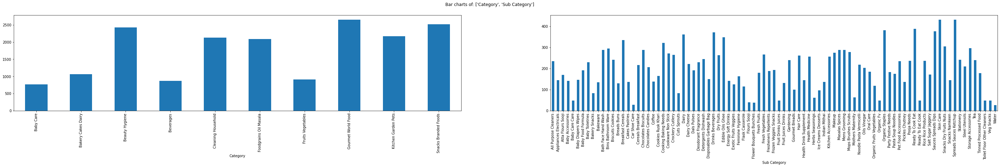

In [10]:
#####################################################################
# Calling the function for 5 columns
PlotBarCharts(inpData=inventory_df, 
              colsToPlot=['Category', 'Sub Category'])

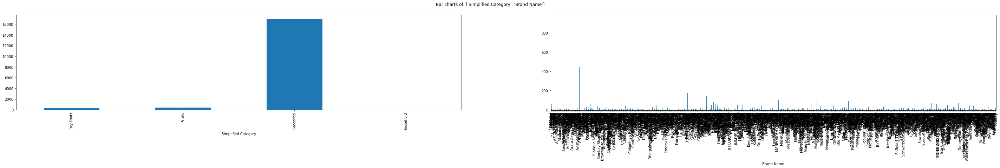

In [11]:
#####################################################################
# Calling the function for 5 columns
PlotBarCharts(inpData=inventory_df, 
              colsToPlot=['Simplified Category', 'Brand Name'])

# Bar Charts Interpretation
These bar charts represent the frequencies of each category in the Y-axis and the category names in the X-axis.

In this data, all the categorical columns except "Brand Name", "Name" and "Product Name" have satisfactory distribution for machine learning.

# Visualize distribution of all the Continuous Predictor variables in the data using histograms

array([[<AxesSubplot:title={'center':'MRP/Unit'}>,
        <AxesSubplot:title={'center':'Rating '}>],
       [<AxesSubplot:title={'center':'No of Users Purchased'}>,
        <AxesSubplot:>]], dtype=object)

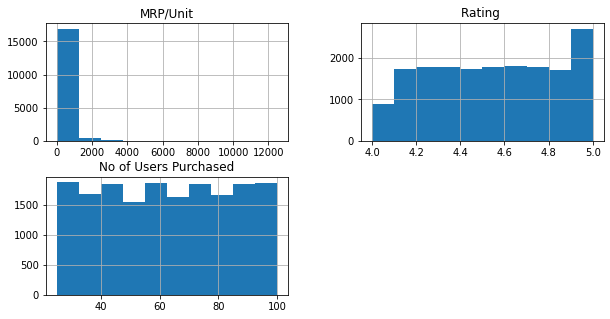

In [12]:
# Plotting histograms of multiple columns together

inventory_df.hist(['MRP/Unit', 'Rating ', 'No of Users Purchased'], figsize=(10, 5))

In [13]:
inventory_df.columns

Index(['Category', 'Sub Category', 'Simplified Category', 'Brand Name',
       'Product Name', 'Weight', 'MRP/Unit', 'Product ID ', 'Image URL',
       'Rating ', 'No of Users Purchased'],
      dtype='object')

array([[<AxesSubplot:title={'center':'Product ID '}>]], dtype=object)

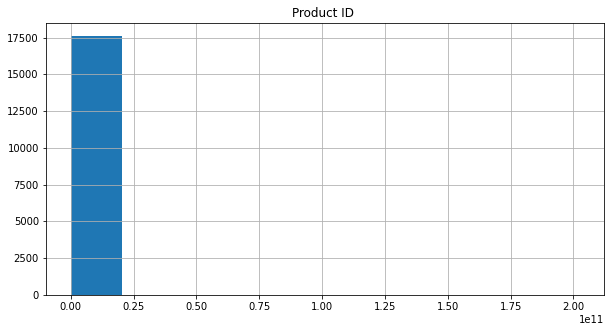

In [14]:
# Plotting histograms of multiple columns together

inventory_df.hist(['Product ID '], figsize=(10,5))

# Histogram Interpretation
Histograms shows us the data distribution for a single continuous variable.

The ideal outcome for histogram is a bell curve or slightly skewed bell curve. If there is too much skewness, then outlier treatment should be done and the column should be re-examined, if that also does not solve the problem then only reject the column.

Selected Continuous Variables:

- MRP/Unit   : Selected. Slightly skewed distribution, acceptable.
- Qnty       : Selected. Slightly skewed distribution, acceptable.
- Unit Qnty  : Selected. Skewed distribution, not acceptable.
- Cost Price : Selected. Slightly skewed distribution, acceptable.


# Outlier treatment
Outliers are extreme values in the data which are far away from most of the values. You can see them as the tails in the histogram.

Outlier must be treated one column at a time. As the treatment will be slightly different for each column.

Why I should treat the outliers?

Outliers bias the training of machine learning models. As the algorithm tries to fit the extreme value, it goes away from majority of the data.

There are below two options to treat outliers in the data.

- Option-1: Delete the outlier Records. Only if there are just few rows lost.
- Option-2: Impute the outlier values with a logical business value

In this data all the continuous variables have slightly skewed distribution, which is acceptable, hence no outlier treatment is required.




1. Rating <0 and >5 
2. simplfied category not in 'Groceries' ,'Fruits' ,'Dry Fruits'
3. Length of productid >12
4. MRP/Unit <0 and MRP/Unit>10000

In [15]:
def outlier_treatment(datacolumn):
    sorted(datacolumn)
    Q1,Q3 = np.percentile(datacolumn , [25,75])
    IQR = Q3 - Q1
    lower_range = Q1 - (1.5 * IQR)
    upper_range = Q3 + (1.5 * IQR)
    return lower_range,upper_range

In [16]:
lowerbound,upperbound = outlier_treatment(inventory_df['Rating '])

In [17]:
# Records not within the boundary
inventory_df[(inventory_df['Rating '] < lowerbound) | (inventory_df['Rating '] > upperbound)]

,Category,Sub Category,Simplified Category,Brand Name,Product Name,Weight,MRP/Unit,Product ID,Image URL,Rating,No of Users Purchased


In [18]:
error_records_df = inventory_df[(inventory_df['Rating '] < lowerbound) | (inventory_df['Rating '] > upperbound)]
error_records_df.drop(['Sub Category', 'Brand Name', 'No of Users Purchased'], axis=1, inplace=True)
error_records_df.rename(columns = {'Category':'Sub_Category_Name', 'Simplified Category':'Category_Name','Product Name':'Product_Name', 'MRP/Unit':'Price','Product ID ':'productid', 'Image URL':'Image', 'Rating ':'Product_Rating'}, inplace= True)
error_records_df.to_csv(unprocessed_data, index=False)

In [19]:
# simplfied category not in 'Groceries' ,'Fruits' ,'Dry Fruits'
inventory_df[(inventory_df['Simplified Category'] != 'Groceries') & (inventory_df['Simplified Category'] != 'Fruits') & (inventory_df['Simplified Category'] != 'Dry Fruits')]

,Category,Sub Category,Simplified Category,Brand Name,Product Name,Weight,MRP/Unit,Product ID,Image URL,Rating,No of Users Purchased
17607,Gourmet World Food,Dairy Cheese,Household,ORGANIC ORIGINS,Butter - Almond Cacao Crunchy,200 g,590.0,202229607.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.6,95


In [20]:
error_records_df =inventory_df[(inventory_df['Simplified Category'] != 'Groceries') & (inventory_df['Simplified Category'] != 'Fruits') & (inventory_df['Simplified Category'] != 'Dry Fruits')]
error_records_df.drop(['Sub Category', 'Brand Name', 'No of Users Purchased'], axis=1, inplace=True)
error_records_df.rename(columns = {'Category':'Sub_Category_Name', 'Simplified Category':'Category_Name','Product Name':'Product_Name', 'MRP/Unit':'Price','Product ID ':'productid', 'Image URL':'Image', 'Rating ':'Product_Rating'}, inplace= True)
error_records_df.to_csv(unprocessed_data, mode='a', index=False, header=False)

In [21]:
# Length of productid > 12
inventory_df[inventory_df['Product ID '].astype(str).str.len() > 12]

,Category,Sub Category,Simplified Category,Brand Name,Product Name,Weight,MRP/Unit,Product ID,Image URL,Rating,No of Users Purchased
17608,Gourmet World Food,Dairy Cheese,Groceries,ORGANIC ORIGINS,Butter - Almond Cacao Crunchy,200 g,590.0,2.020000e+11,https://www.bigbasket.com/media/uploads/p/s/40...,4.6,95


In [22]:
error_records_df = inventory_df[inventory_df['Product ID '].astype(str).str.len() > 12]
error_records_df.drop(['Sub Category', 'Brand Name', 'No of Users Purchased'], axis=1, inplace=True)
error_records_df.rename(columns = {'Category':'Sub_Category_Name', 'Simplified Category':'Category_Name','Product Name':'Product_Name', 'MRP/Unit':'Price','Product ID ':'productid', 'Image URL':'Image', 'Rating ':'Product_Rating'}, inplace= True)
error_records_df.to_csv(unprocessed_data, mode='a', index=False, header=False)

In [23]:
# MRP/Unit <0 and MRP/Unit>10000
inventory_df[(inventory_df['MRP/Unit'] < 0) | (inventory_df['MRP/Unit'] > 10000)]

,Category,Sub Category,Simplified Category,Brand Name,Product Name,Weight,MRP/Unit,Product ID,Image URL,Rating,No of Users Purchased
8646,Kitchen Garden Pets,Pet Food Accessories,Groceries,Wahl,Bravura Clipper,1 pc,12500.0,202220647.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.1,78
12602,Kitchen Garden Pets,Storage Accessories,Groceries,DP,"Premium Cloth Dryer/Drying Stand - Foldable, G...",1 pc,11729.0,202224603.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.2,73


In [24]:
error_records_df = inventory_df[(inventory_df['MRP/Unit'] < 0) | (inventory_df['MRP/Unit'] > 10000)]
error_records_df.drop(['Sub Category', 'Brand Name', 'No of Users Purchased'], axis=1, inplace=True)
error_records_df.rename(columns = {'Category':'Sub_Category_Name', 'Simplified Category':'Category_Name','Product Name':'Product_Name', 'MRP/Unit':'Price','Product ID ':'productid', 'Image URL':'Image', 'Rating ':'Product_Rating'}, inplace= True)
error_records_df.to_csv(unprocessed_data, mode='a', index=False, header=False)

In [25]:
# remove the outliers from the dataset

inventory_df.drop(inventory_df[ (inventory_df['Rating '] > upperbound) | (inventory_df['Rating '] < lowerbound) ].index , inplace=True)

inventory_df.drop(inventory_df[(inventory_df['Simplified Category'] != 'Groceries') & (inventory_df['Simplified Category'] != 'Fruits') & (inventory_df['Simplified Category'] != 'Dry Fruits')].index, inplace=True)

inventory_df.drop(inventory_df[inventory_df['Product ID '].astype(str).str.len() > 12].index, inplace=True)

inventory_df.drop(inventory_df[(inventory_df['MRP/Unit'] < 0) | (inventory_df['MRP/Unit'] > 10000)].index, inplace=True)


# Missing values treatment
Missing values are treated for each column separately.

If a column has more than 30% data missing, then missing value treatment cannot be done. That column must be rejected because too much information is missing.

There are below options for treating missing values in data.

- Delete the missing value rows if there are only few records
- Impute the missing values with MEDIAN value for continuous variables
- Impute the missing values with MODE value for categorical variables
- Interpolate the values based on nearby values
- Interpolate the values based on business logic

In [26]:
# Finding how many missing values are there for each column
inventory_df.isnull().sum()

Category                 0
Sub Category             0
Simplified Category      0
Brand Name               1
Product Name             0
Weight                   0
MRP/Unit                 0
Product ID               0
Image URL                0
Rating                   0
No of Users Purchased    0
dtype: int64

In [27]:
error_records_df = inventory_df[inventory_df.isnull().any(axis=1)]
error_records_df.drop(['Sub Category', 'Brand Name', 'No of Users Purchased'], axis=1, inplace=True)
error_records_df.rename(columns = {'Category':'Sub_Category_Name', 'Simplified Category':'Category_Name','Product Name':'Product_Name', 'MRP/Unit':'Price','Product ID ':'productid', 'Image URL':'Image', 'Rating ':'Product_Rating'}, inplace= True)
error_records_df.to_csv(unprocessed_data, mode='a', index=False, header=False)
error_records_df

,Sub_Category_Name,Category_Name,Product_Name,Weight,Price,productid,Image,Product_Rating
17605,Gourmet World Food,Groceries,"Butter - Almond, Smooth",200 g,490.0,202229606.0,https://www.bigbasket.com/media/uploads/p/s/40...,4.7


In [28]:
inventory_df.replace('', np.nan, inplace=True)

In [29]:
inventory_df.dropna(inplace=True)

# Finding how many missing values are there for each column
inventory_df.isnull().sum()

Category                 0
Sub Category             0
Simplified Category      0
Brand Name               0
Product Name             0
Weight                   0
MRP/Unit                 0
Product ID               0
Image URL                0
Rating                   0
No of Users Purchased    0
dtype: int64

All the missing values are removed now.

# Data Cleansing

In [30]:
# Removing the leading and trailing spaces of columns
inventory_df.columns = inventory_df.columns.str.strip()

In [31]:
inventory_df.columns

Index(['Category', 'Sub Category', 'Simplified Category', 'Brand Name',
       'Product Name', 'Weight', 'MRP/Unit', 'Product ID', 'Image URL',
       'Rating', 'No of Users Purchased'],
      dtype='object')

# Find Correalation between attributes

In [32]:
# To find the correlation among
# the columns using pearson method
inventory_df.corr(method ='pearson')

,MRP/Unit,Product ID,Rating,No of Users Purchased
MRP/Unit,1.000000,-0.002626,0.003913,-0.002747
Product ID,-0.002626,1.000000,-0.000753,0.007996
Rating,0.003913,-0.000753,1.000000,0.002461
No of Users Purchased,-0.002747,0.007996,0.002461,1.000000


# Save the file into local machine

In [33]:
inventory_df.drop(['Sub Category', 'Brand Name', 'No of Users Purchased'], axis=1, inplace=True)

In [34]:
inventory_df.rename(columns = {'Category':'Sub_Category_Name', 'Simplified Category':'Category_Name','Product Name':'Product_Name', 'MRP/Unit':'Price','Product ID':'productid', 'Image URL':'Image', 'Rating':'Product_Rating'}, inplace= True)

In [35]:
inventory_df.to_csv(preprocessed_data, index=False)

# Save the data into local database

('Snacks Branded Foods', 'Groceries', 'Idly Dosa Batter, 1 Kg + Malabar Parota, 350 g', 'Combo 2 Items', 155.0, 202212001, 'https://www.bigbasket.com/media/uploads/p/s/1214118_1-id-fresho-idly-dosa-batter-1-kg-malabar-parota-350-g.jpg', 4.4)
('Snacks Branded Foods', 'Groceries', 'Malabar Parota/Paratha', '350 g Pouch ', 80.0, 202212002, 'https://www.bigbasket.com/media/uploads/p/s/30003294_14-id-fresho-malabar-parotaparatha.jpg', 4.6)
('Snacks Branded Foods', 'Groceries', 'Whole Wheat Parota, 350 g + Malabar Parota, 350 g', 'Combo 2 Items', 160.0, 202212003, 'https://www.bigbasket.com/media/uploads/p/s/1214119_1-id-fresho-whole-wheat-parota-350-g-malabar-parota-350-g.jpg', 4.6)
('Snacks Branded Foods', 'Groceries', 'Wheat Chapati', '350 g ', 70.0, 202212004, 'https://www.bigbasket.com/media/uploads/p/s/30003296_10-id-wheat-chapati.jpg', 4.4)
('Snacks Branded Foods', 'Groceries', 'Breakfast Mix - Khaman Dhokla', '160 g Pouch', 60.0, 202212005, 'https://www.bigbasket.com/media/uploads/p/

('Beverages', 'Groceries', 'Gold Dust Tea', '500 g  ', 360.0, 202214237, 'https://www.bigbasket.com/media/uploads/p/s/297576_10-tata-tea-chakra-gold-dust-tea.jpg', 4.6)
('Beverages', 'Groceries', 'Yellow Label Tea - Finest Blend', '250 g ', 300.0, 202214238, 'https://www.bigbasket.com/media/uploads/p/s/262811_16-lipton-yellow-label-tea-finest-blend.jpg', 4.7)
('Beverages', 'Groceries', 'Tea - Golden Leaf', '500 g  ', 250.0, 202214239, 'https://www.bigbasket.com/media/uploads/p/s/40026308_2-tata-tea-kanan-devan-tea-golden-leaf.jpg', 4.3)
('Beverages', 'Groceries', 'Top Star', '500 g Carton ', 360.0, 202214240, 'https://www.bigbasket.com/media/uploads/p/s/40002111_10-3-roses-top-star.jpg', 4.4)
('Beverages', 'Groceries', 'Leaf Tea', '1 kg ', 320.0, 202214241, 'https://www.bigbasket.com/media/uploads/p/s/40026310_4-tata-tea-agni-leaf-tea.jpg', 4.8)
('Beverages', 'Groceries', 'Chakra Gold Elaichi Tea', '250 g  ', 195.0, 202214242, 'https://www.bigbasket.com/media/uploads/p/s/40176772_4-tat
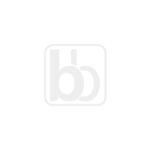


('Gourmet World Food', 'Groceries', 'Greek Yogurt Smoothie - Strawberry', '3x200 ml Multipack ', 210.0, 202217149, 'https://www.bigbasket.com/media/uploads/p/s/1215371_1-epigamia-greek-yogurt-smoothie-strawberry.jpg', 4.6)
('Gourmet World Food', 'Groceries', 'Garlic Dip - Yoghurt Based', '3x150 g Multipack ', 600.0, 202217150, 'https://www.bigbasket.com/media/uploads/p/s/1215176_1-wingreens-farms-garlic-dip-yoghurt-based.jpg', 4.5)
('Gourmet World Food', 'Groceries', 'Greek Yogurt - Alphonso Mango', '400 g  ', 200.0, 202217151, 'https://www.bigbasket.com/media/uploads/p/s/40218839_2-epigamia-greek-yogurt-alphonso-mango.jpg', 4.5)
('Gourmet World Food', 'Groceries', 'Peri Peri Garlic Dip - Yoghurt Based', '2 x 150 g Multipack ', 400.0, 202217152, 'https://www.bigbasket.com/media/uploads/p/s/1213994_1-wingreens-farms-peri-peri-garlic-dip-yoghurt-based.jpg', 4.0)
('Gourmet World Food', 'Groceries', 'Dill Tzatziki Dip - Yoghurt Based', '3x150 g Multipack ', 600.0, 202217153, 'https://www.

('Bakery Cakes Dairy', 'Groceries', 'Cholesterol Free - Spread', '100 g Carton ', 18.0, 202219417, 'https://www.bigbasket.com/media/uploads/p/s/161898_2-delicious-cholesterol-free-spread.jpg', 4.9)
('Bakery Cakes Dairy', 'Groceries', 'Cooking Butter', '3x200 g Multipack ', 354.0, 202219418, 'https://www.bigbasket.com/media/uploads/p/s/1213685_2-milky-mist-cooking-butter.jpg', 4.7)
('Bakery Cakes Dairy', 'Groceries', 'DoodhShakti Probiotic Butter(Salted)', '3x100 g Multipack ', 150.0, 202219419, 'https://www.bigbasket.com/media/uploads/p/s/1214894_1-nutralite-doodhshakti-probiotic-buttersalted.jpg', 4.2)
('Bakery Cakes Dairy', 'Groceries', 'Cooking Butter - Unsalted, Organic, Tub', '200 g Tub', 230.0, 202219420, 'https://www.bigbasket.com/media/uploads/p/s/40135124_3-akshayakalpa-cooking-butter-unsalted-organic-tub.jpg', 4.6)
('Bakery Cakes Dairy', 'Groceries', 'Cooking Butter', '500 g Carton ', 250.0, 202219421, 'https://www.bigbasket.com/media/uploads/p/s/225761_2-heritage-cooking-but
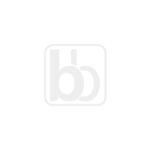


('Kitchen Garden Pets', 'Groceries', 'Chyawanprakash - Sugar Free', '900 g Jar ', 399.0, 202221687, 'https://www.bigbasket.com/media/uploads/p/s/30009463_9-dabur-chyawanprakash-sugar-free.jpg', 4.2)
('Kitchen Garden Pets', 'Groceries', 'Double Side Cotton Pads', '80 pcs (Get 30% Extra) ', 139.0, 202221688, 'https://www.bigbasket.com/media/uploads/p/s/209583_11-bella-double-side-cotton-pads.jpg', 4.3)
('Snacks Branded Foods', 'Groceries', 'Corn Flakes With Real Almond & Honey', '1 Kg  ', 550.0, 202221689, 'https://www.bigbasket.com/media/uploads/p/s/40092421_21-kelloggs-corn-flakes-with-real-almond-honey.jpg', 4.4)
('Snacks Branded Foods', 'Groceries', 'Corn Flakes', '875 g ', 310.0, 202221690, 'https://www.bigbasket.com/media/uploads/p/s/40015688_22-kelloggs-corn-flakes.jpg', 4.4)
('Snacks Branded Foods', 'Groceries', 'Corn Flakes', '250 g  ', 95.0, 202221691, 'https://www.bigbasket.com/media/uploads/p/s/251020_6-kelloggs-corn-flakes.jpg', 4.3)
('Snacks Branded Foods', 'Groceries', 'S

('Foodgrains Oil Masala', 'Groceries', 'Phool Makhana', '200 g  ', 400.0, 202224248, 'https://www.bigbasket.com/media/uploads/p/s/40128952_4-bb-royal-phool-makhana.jpg', 4.3)
('Foodgrains Oil Masala', 'Groceries', 'Organic - Cumin/Jeera/Jeerige', '100 g  ', 51.0, 202224249, 'https://www.bigbasket.com/media/uploads/p/s/40072474_16-bb-royal-organic-cuminjeera.jpg', 4.6)
('Foodgrains Oil Masala', 'Groceries', 'Black Pepper/Kari Menasu', '100 g Pouch ', 100.0, 202224250, 'https://www.bigbasket.com/media/uploads/p/s/40073431_10-bb-popular-black-pepperkali-mirch.jpg', 4.7)
('Foodgrains Oil Masala', 'Groceries', 'Fenugreek/Methi/Menthya', '200 g  ', 60.0, 202224251, 'https://www.bigbasket.com/media/uploads/p/s/40067276_5-bb-popular-fenugreekmethi.jpg', 4.0)
('Foodgrains Oil Masala', 'Groceries', 'Coriander Seeds/Kottambari Beeja', '200 g  ', 80.0, 202224252, 'https://www.bigbasket.com/media/uploads/p/s/40000625_11-bb-royal-corianderdhania-seeds.jpg', 4.6)
('Foodgrains Oil Masala', 'Groceries'

('Gourmet World Food', 'Groceries', 'Tuna Flakes - White Meat In Sunflower Oil', '185 g Can', 190.0, 202226524, 'https://www.bigbasket.com/media/uploads/p/s/40176766_4-tasty-nibbles-tuna-flakes-white-meat-in-sunflower-oil.jpg', 4.7)
('Gourmet World Food', 'Groceries', 'Canned Skipjack Light Meat Tuna - Chunk In Soya Bean Oil', '185 g ', 205.0, 202226525, 'https://www.bigbasket.com/media/uploads/p/s/40037993_7-golden-prize-canned-skipjack-light-meat-tuna-chunk-in-soya-bean-oil.jpg', 4.7)
('Gourmet World Food', 'Groceries', 'Canned Tuna Chunks in Tomato Sauce', '185 g ', 195.0, 202226526, 'https://www.bigbasket.com/media/uploads/p/s/40096822_6-golden-prize-canned-tuna-chunks-in-tomato-sauce.jpg', 4.9)
('Gourmet World Food', 'Groceries', 'Canned Sardine In Brine', '200 g ', 109.0, 202226527, 'https://www.bigbasket.com/media/uploads/p/s/40037997_5-golden-prize-canned-sardine-in-brine.jpg', 4.7)
('Gourmet World Food', 'Groceries', 'Tuna Chunks In Brine', '160 g Can', 130.0, 202226528, 'http

('Snacks Branded Foods', 'Groceries', 'Gulab Jamun', '2 x 500 g Multipack ', 410.0, 202228789, 'https://www.bigbasket.com/media/uploads/p/s/1212404_1-gits-gulab-jamun.jpg', 4.4)
('Snacks Branded Foods', 'Groceries', 'Gulab Jamun Instant Mix', '175 g (Buy 1 Get 1 Free)', 130.0, 202228790, 'https://www.bigbasket.com/media/uploads/p/s/40001310_4-aashirvaad-gulab-jamun-instant-mix.jpg', 4.8)
('Snacks Branded Foods', 'Groceries', 'Mix - Gulab Jamun', '100 g Pouch', 75.0, 202228791, 'https://www.bigbasket.com/media/uploads/p/s/40003524_1-grb-mix-gulab-jamun.jpg', 4.3)
('Snacks Branded Foods', 'Groceries', 'Custard Powder Butterscotch', '75 g Carton', 40.0, 202228792, 'https://www.bigbasket.com/media/uploads/p/s/40008367_3-weikfield-custard-powder-butterscotch.jpg', 5.0)
('Snacks Branded Foods', 'Groceries', 'Palada Payasam Mix - Rice', '200 g Pouch', 65.0, 202228793, 'https://www.bigbasket.com/media/uploads/p/s/40009953_10-double-horse-palada-payasam-mix-rice.jpg', 4.1)
('Snacks Branded Food


('Gourmet World Food', 'Groceries', 'Ice Cream - Double Chocolate, Family Pack', '1 L Tub', 800.0, 202213657, 'https://www.bigbasket.com/media/uploads/p/s/40008511_12-london-dairy-ice-cream-double-chocolate-family-pack.jpg', 4.4)
('Beauty Hygiene', 'Groceries', 'Antiseptic Disinfectant Liquid', '550 ml  ', 194.6, 202213658, 'https://www.bigbasket.com/media/uploads/p/s/208003_10-dettol-antiseptic-disinfectant-liquid.jpg', 4.5)
('Beauty Hygiene', 'Groceries', 'Antiseptic - Disinfectant Liquid 1 L + Clinical Strength Hand Sanitizer 500 ml', 'Combo 2 Items', 552.41, 202213659, 'https://www.bigbasket.com/media/uploads/p/s/1212722_1-dettol-antiseptic-disinfectant-liquid-1-l-clinical-strength-hand-sanitizer-500-ml.jpg', 4.8)
('Beauty Hygiene', 'Groceries', 'Antiseptic- Disinfectant Liquid 250 ml + Clinical Strength Hand Sanitizer 500 ml', 'Combo 2 Items', 337.16, 202213660, 'https://www.bigbasket.com/media/uploads/p/s/1212720_1-dettol-antiseptic-disinfectant-liquid-250-ml-clinical-strength-h
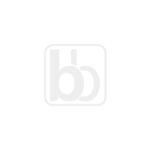


('Snacks Branded Foods', 'Groceries', 'Vermicelli - Rice Sevai', '400 g Pouch ', 50.0, 202216018, 'https://www.bigbasket.com/media/uploads/p/s/266014_1-mtr-vermicelli-rice-sevai.jpg', 4.8)
('Snacks Branded Foods', 'Groceries', 'Ragi Vermicelli - Finger Millet-Semiya', '200 g Pouch', 25.0, 202216019, 'https://www.bigbasket.com/media/uploads/p/s/40001253_7-manna-ragi-vermicelli-finger-millet-semiya.jpg', 4.9)
('Snacks Branded Foods', 'Groceries', 'Vermicelli - Roasted', '200 g Pouch', 45.0, 202216020, 'https://www.bigbasket.com/media/uploads/p/s/274817_2-azad-vermicelli-roasted.jpg', 4.8)
('Snacks Branded Foods', 'Groceries', 'Vermicelli  - Roasted', '200 g Pouch ', 33.0, 202216021, 'https://www.bigbasket.com/media/uploads/p/s/30004905_2-double-horse-vermicelli-roasted.jpg', 4.8)
('Snacks Branded Foods', 'Groceries', 'Roasted Vermicelli', '2x400 g Multipack ', 118.0, 202216022, 'https://www.bigbasket.com/media/uploads/p/s/1212828_3-bb-royal-roasted-vermicelli.jpg', 4.0)
('Snacks Branded


('Kitchen Garden Pets', 'Groceries', 'Vision Ultra Headlight HDE32 ULT40', '1 pc ', 1760.0, 202218276, 'https://www.bigbasket.com/media/uploads/p/s/40226199_1-energizer-vision-ultra-headlight-hde32-ult40.jpg', 4.9)
('Kitchen Garden Pets', 'Groceries', 'X Focus Torch XFH211', '1 pc ', 770.0, 202218277, 'https://www.bigbasket.com/media/uploads/p/s/40226196_1-energizer-x-focus-torch-xfh211.jpg', 4.0)
('Kitchen Garden Pets', 'Groceries', 'Performance Metal Pen Inspection Torch PLM22', '1 pc ', 499.0, 202218278, 'https://www.bigbasket.com/media/uploads/p/s/40226195_1-energizer-performance-metal-pen-inspection-torch-plm22.jpg', 4.5)
('Kitchen Garden Pets', 'Groceries', 'Carbon Zinc Battery - Jumbo AA', '10 pcs ', 150.0, 202218279, 'https://www.bigbasket.com/media/uploads/p/s/40183480_4-panasonic-carbon-zinc-battery-jumbo-aa.jpg', 4.9)
('Kitchen Garden Pets', 'Groceries', 'Clippy 2 Pin Extension Box With 5 Meter Wire 1086', '1 pc ', 504.0, 202218280, 'https://www.bigbasket.com/media/uploads/

('Beverages', 'Groceries', 'Syrup - Vanille Flavored', '250 ml Bottle', 395.0, 202220599, 'https://www.bigbasket.com/media/uploads/p/s/40002172_3-monin-syrup-vanille-flavored.jpg', 4.6)
('Beverages', 'Groceries', 'Syrup - Passion Fruit Flavored', '250 ml Bottle', 395.0, 202220600, 'https://www.bigbasket.com/media/uploads/p/s/40002193_1-monin-syrup-passion-fruit-flavored.jpg', 5.0)
('Beverages', 'Groceries', 'Syrup - Green Apple Flavored', '250 ml Bottle', 395.0, 202220601, 'https://www.bigbasket.com/media/uploads/p/s/40017220_3-monin-syrup-green-apple-flavored.jpg', 4.5)
('Beverages', 'Groceries', 'Tang Orange Instant Drink Mix 750G + Lion Dates - Deseeded 200G', 'Combo 2 Items', 269.0, 202220602, 'https://www.bigbasket.com/media/uploads/p/s/1204251_2-bb-combo-tang-orange-instant-drink-mix-750g-lion-dates-deseeded-200g.jpg', 4.8)
('Beverages', 'Groceries', 'Nimbu Pani Flavoured Glucose Based Beverage Mix', '1 Kg Carton (Get Sipper Free)', 330.0, 202220603, 'https://www.bigbasket.com/me
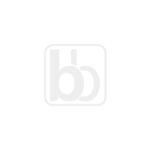

('Beverages', 'Groceries', 'Organic Ashwagandha Cinnamon Instant Tea Premix - With Whole Milk Powder', '80 g (10 Sachets x 8 g each)', 249.0, 202222555, 'https://www.bigbasket.com/media/uploads/p/s/40207283_1-vahdam-organic-ashwagandha-cinnamon-instant-tea-premix-with-whole-milk-powder.jpg', 4.1)
('Beverages', 'Groceries', 'Infusion Tea - Tulsi Sweet Rose', '40 g (25 Bags x 1.6 g each)', 168.0, 202222556, 'https://www.bigbasket.com/media/uploads/p/s/100170220_4-organic-india-infusion-tea-tulsi-sweet-rose.jpg', 4.6)
('Beverages', 'Groceries', 'Organic Dia Health Tea - Herbal Infusion For Diabetes Support', '18.75 g (15 Bags x 1.25 g each)', 100.0, 202222557, 'https://www.bigbasket.com/media/uploads/p/s/40187672_2-18-herbs-organic-dia-health-tea-herbal-infusion-for-diabetes-support.jpg', 4.9)
('Beverages', 'Groceries', 'Organic Mulberry Wellness Drink - Natural', '20 g (10 Sachets x 2 g each) ', 120.0, 202222558, 'https://www.bigbasket.com/media/uploads/p/s/40175229_4-sericha-organic-mul

('Gourmet World Food', 'Groceries', 'Pure Cocoa Butter', '150 g Jar', 450.0, 202224723, 'https://www.bigbasket.com/media/uploads/p/s/40177810_1-urban-platter-pure-cocoa-butter.jpg', 4.9)
('Gourmet World Food', 'Groceries', 'Peanut Satay Sauce', '170 ml Bottle', 220.0, 202224724, 'https://www.bigbasket.com/media/uploads/p/s/40188622_2-real-thai-peanut-satay-sauce.jpg', 4.3)
('Gourmet World Food', 'Groceries', 'Massaman Curry Paste', '227 g ', 215.0, 202224725, 'https://www.bigbasket.com/media/uploads/p/s/40003607_8-real-thai-massaman-curry-paste.jpg', 4.7)
('Gourmet World Food', 'Groceries', 'Green Curry With Vegetable', '300 g ', 275.0, 202224726, 'https://www.bigbasket.com/media/uploads/p/s/40003597_8-real-thai-green-curry-with-vegetable.jpg', 4.9)
('Gourmet World Food', 'Groceries', 'Coconut Milk', '400 ml ', 110.0, 202224727, 'https://www.bigbasket.com/media/uploads/p/s/800188151_2-habit-coconut-milk.jpg', 4.1)
('Gourmet World Food', 'Groceries', 'Paste - Wasabi', '50 g ', 399.0, 20

('Kitchen Garden Pets', 'Groceries', 'Opalware Dinner Set - English Lavender', '15 pcs ', 1375.0, 202227161, 'https://www.bigbasket.com/media/uploads/p/s/40134213_6-laopala-opalware-dinner-set-english-lavender.jpg', 4.8)
('Kitchen Garden Pets', 'Groceries', 'Pure Melamine Traditional Dinner Set - Water Lily', '24 pcs ', 2795.0, 202227162, 'https://www.bigbasket.com/media/uploads/p/s/40136922_3-servewell-pure-melamine-traditional-dinner-set-water-lily.jpg', 4.2)
('Kitchen Garden Pets', 'Groceries', 'Pure Melamine Traditional Dinner Set - Garden Of Love', '24 pcs ', 2795.0, 202227163, 'https://www.bigbasket.com/media/uploads/p/s/40136924_3-servewell-pure-melamine-traditional-dinner-set-garden-of-love.jpg', 5.0)
('Kitchen Garden Pets', 'Groceries', 'Opalware Classique 2 Dinner Set - Mystrio Black', '27 pcs ', 3395.0, 202227164, 'https://www.bigbasket.com/media/uploads/p/s/40133361_3-laopala-diva-opalware-classique-2-dinner-set-mystrio-black.jpg', 4.9)
('Kitchen Garden Pets', 'Groceries', 


('Snacks Branded Foods', 'Groceries', 'Heat To Eat - Spicy Vegetable Biryani', '330 g ', 99.0, 202212042, 'https://www.bigbasket.com/media/uploads/p/s/40180762_5-tata-q-heat-to-eat-spicy-vegetable-biryani.jpg', 4.5)
('Snacks Branded Foods', 'Groceries', 'Hyderabadi Biryani & Butter Chicken Ready to Eat Masala Paste, 80 g', 'Combo 2 Items', 150.0, 202212043, 'https://www.bigbasket.com/media/uploads/p/s/1213031_1-itc-master-chef-hyderabadi-biryani-butter-chicken-ready-to-eat-masala-paste-80-g.jpg', 4.1)
('Snacks Branded Foods', 'Groceries', 'Ready To Eat - Dal Bukhara', '285 g ', 110.0, 202212044, 'https://www.bigbasket.com/media/uploads/p/s/40001333_2-kitchens-of-india-ready-to-eat-dal-bukhara.jpg', 4.1)
('Snacks Branded Foods', 'Groceries', 'Ready To Eat - Pongal', '300 g Carton', 99.0, 202212045, 'https://www.bigbasket.com/media/uploads/p/s/265994_1-mtr-ready-to-eat-pongal.jpg', 4.7)
('Snacks Branded Foods', 'Groceries', 'Hyderabadi Biryani Masala Paste - Ready To Cook', '2x150 g Mul
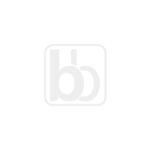

('Fruits Vegetables', 'Fruits', 'Banana - Raw - Organically Grown', '2 pcs ', 26.25, 202214489, 'https://www.bigbasket.com/media/uploads/p/s/40229400_1-fresho-banana-raw-organically-grown.jpg', 4.8)
('Fruits Vegetables', 'Fruits', 'Pomegranate - Organically Grown', '4 pcs ', 231.25, 202214490, 'https://www.bigbasket.com/media/uploads/p/s/40229399_1-fresho-pomegranate-organically-grown.jpg', 4.6)
('Fruits Vegetables', 'Fruits', 'Apple - Red Delicious, Organically Grown', '4 pcs  ', 163.75, 202214491, 'https://www.bigbasket.com/media/uploads/p/s/40093037_13-fresho-apple-red-delicious-organically-grown.jpg', 4.6)
('Fruits Vegetables', 'Fruits', 'Avocado - Organically Grown', '500 g ', 155.0, 202214492, 'https://www.bigbasket.com/media/uploads/p/s/40049412_3-fresho-avocado-organically-grown.jpg', 4.1)
('Fruits Vegetables', 'Fruits', 'Figs - Organically Grown', '6 pcs ', 47.5, 202214493, 'https://www.bigbasket.com/media/uploads/p/s/50000505_1-fresho-figs-organically-grown.jpg', 4.5)
('Fruit

('Gourmet World Food', 'Groceries', 'Muesli - Simply Delicious', '620 g Carton', 635.0, 202217021, 'https://www.bigbasket.com/media/uploads/p/s/30003481_3-dorset-muesli-simply-delicious.jpg', 4.1)
('Gourmet World Food', 'Groceries', 'Muesli - Gluten Free', '453 g ', 790.0, 202217022, 'https://www.bigbasket.com/media/uploads/p/s/40123291_6-bobs-red-mill-muesli-gluten-free.jpg', 4.5)
('Gourmet World Food', 'Groceries', 'Muesli - Wholegrain Fruits & Oats', '375 g Carton', 495.0, 202217023, 'https://www.bigbasket.com/media/uploads/p/s/70001360_2-kolln-muesli-wholegrain-fruits-oats.jpg', 4.1)
('Gourmet World Food', 'Groceries', 'Butterscotch Muesli 400 g Container + Muesli Cranberry Blueberry 400 g', 'Combo (2 Items)', 515.0, 202217024, 'https://www.bigbasket.com/media/uploads/p/s/1208703_1-true-elements-butterscotch-muesli-400-g-container-muesli-cranberry-blueberry-400-g.jpg', 4.8)
('Gourmet World Food', 'Groceries', 'Toasted Millet Muesli - Roasted Cacao Bean & Raisin', '250 g ', 230.0, 2


('Cleaning Household', 'Groceries', 'Squeeze Me Rangoli Bottles', '100 ml (Set of 10)', 250.0, 202218925, 'https://www.bigbasket.com/media/uploads/p/s/40228775_1-tota-squeeze-me-rangoli-bottles.jpg', 4.4)
('Cleaning Household', 'Groceries', 'Party Popper - Colourful', '1 pc ', 95.0, 202218926, 'https://www.bigbasket.com/media/uploads/p/s/40228781_1-tota-party-popper-colourful.jpg', 4.3)
('Cleaning Household', 'Groceries', 'Moli Kalava', '1 pc ', 20.0, 202218927, 'https://www.bigbasket.com/media/uploads/p/s/40228767_1-tota-moli-kalava.jpg', 4.3)
('Cleaning Household', 'Groceries', 'Color - Rangoli Kit', '4 Colors ', 99.0, 202218928, 'https://www.bigbasket.com/media/uploads/p/s/40017902_1-om-bhakti-color-rangoli-kit.jpg', 4.2)
('Cleaning Household', 'Groceries', 'Decorative Roll/Crepe Stremer - Large', '305 x 457 mm (Pack of 12)', 59.0, 202218929, 'https://www.bigbasket.com/media/uploads/p/s/40196516_1-b-vishal-decorative-rollcrepe-stremer-large.jpg', 4.5)
('Cleaning Household', 'Grocer
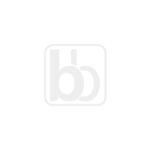


('Bakery Cakes Dairy', 'Groceries', 'Tricone - Cookie Crunch Delight Ice Cream', '120 ml ', 30.0, 202221215, 'https://www.bigbasket.com/media/uploads/p/s/40196309_1-amul-tricone-cookie-crunch-delight-ice-cream.jpg', 4.5)
('Bakery Cakes Dairy', 'Groceries', 'Magnum - Brownie Ice Cream', '80 ml  ', 90.0, 202221216, 'https://www.bigbasket.com/media/uploads/p/s/40079773_4-kwality-walls-magnum-brownie-ice-cream.jpg', 4.8)
('Bakery Cakes Dairy', 'Groceries', 'Natural Ice Cream - Tender Coconut', '750 ml ', 350.0, 202221217, 'https://www.bigbasket.com/media/uploads/p/s/40196361_1-nic-natural-ice-cream-tender-coconut.jpg', 4.6)
('Bakery Cakes Dairy', 'Groceries', 'Tricone - Butterscotch Ice Cream', '120 ml ', 25.0, 202221218, 'https://www.bigbasket.com/media/uploads/p/s/40196307_1-amul-tricone-butterscotch-ice-cream.jpg', 4.1)
('Bakery Cakes Dairy', 'Groceries', 'Frozen Dessert - Oreo & Creme', '700 ml ', 265.0, 202221219, 'https://www.bigbasket.com/media/uploads/p/s/40163753_2-kwality-walls-


('Snacks Branded Foods', 'Groceries', 'Protein Bar Choco Cardamom', '65 g ', 125.0, 202224094, 'https://www.bigbasket.com/media/uploads/p/s/40176785_3-unibic-protein-bar-choco-cardamom.jpg', 4.5)
('Snacks Branded Foods', 'Groceries', 'Belligo - Probiotics + Prebiotics Bites, 2+ Years', '60 g ', 100.0, 202224095, 'https://www.bigbasket.com/media/uploads/p/s/40187966_2-timios-belligo-probiotics-prebiotics-bites-2-years.jpg', 4.6)
('Snacks Branded Foods', 'Groceries', 'Cranberry Super Grain Granola', '300 g ', 450.0, 202224096, 'https://www.bigbasket.com/media/uploads/p/s/900448352_2-nourish-organics-cranberry-super-grain-granola.jpg', 4.9)
('Snacks Branded Foods', 'Groceries', 'Nuts & Seeds Bar', '35 g (12 x 35 g each)', 480.0, 202224097, 'https://www.bigbasket.com/media/uploads/p/s/40172416_5-ritebite-max-protein-nuts-seeds-bar.jpg', 4.7)
('Snacks Branded Foods', 'Groceries', 'Grain-Free Cereal - No Added Oil Or Sugar', '400 g Box', 650.0, 202224098, 'https://www.bigbasket.com/media/up


('Foodgrains Oil Masala', 'Groceries', 'Salt/Uppu', '1 kg Pouch', 35.0, 202226266, 'https://www.bigbasket.com/media/uploads/p/s/209285_4-saffola-salt.jpg', 5.0)
('Foodgrains Oil Masala', 'Groceries', 'Himalayan Pink Salt/Uppu Granules', '500 g ', 70.0, 202226267, 'https://www.bigbasket.com/media/uploads/p/s/40128468_5-natural-tattva-himalayan-pink-salt-granules.jpg', 4.4)
('Foodgrains Oil Masala', 'Groceries', 'Sprinklers - Iodised Table Salt/Uppu', '200 g Can', 35.0, 202226268, 'https://www.bigbasket.com/media/uploads/p/s/266592_4-catch-sprinklers-iodised-table-salt.jpg', 4.4)
('Foodgrains Oil Masala', 'Groceries', 'Salt/Uppu - Proactive', '1 kg ', 40.0, 202226269, 'https://www.bigbasket.com/media/uploads/p/s/40200518_3-aashirvaad-salt-proactive.jpg', 4.8)
('Foodgrains Oil Masala', 'Groceries', 'Pink Salt/Uppu Powder', '500 g ', 99.0, 202226270, 'https://www.bigbasket.com/media/uploads/p/s/40198160_2-himalayan-natives-pink-salt-powder.jpg', 4.5)
('Foodgrains Oil Masala', 'Groceries',


('Cleaning Household', 'Groceries', 'Absolute Extra Dark Pencil', '10 pcs ', 70.0, 202228503, 'https://www.bigbasket.com/media/uploads/p/s/20004341_1-apsara-absolute-extra-dark-pencil.jpg', 4.5)
('Cleaning Household', 'Groceries', 'Ball Pen - Blue, Octane, Blister Pack', '5 pcs  ', 50.0, 202228504, 'https://www.bigbasket.com/media/uploads/p/s/40125810_4-classmate-ball-pen-blue-octane-blister-pack.jpg', 4.7)
('Cleaning Household', 'Groceries', 'Ball Pen - Brite Black', '2 x 5 pcs Multipack ', 50.0, 202228505, 'https://www.bigbasket.com/media/uploads/p/s/1213449_1-reynolds-ball-pen-brite-black.jpg', 4.3)
('Cleaning Household', 'Groceries', 'Fusion X-Tra Super Dark Pencils', '10 pcs ', 70.0, 202228506, 'https://www.bigbasket.com/media/uploads/p/s/40193152_2-doms-fusion-x-tra-super-dark-pencils.jpg', 4.3)
('Cleaning Household', 'Groceries', 'Upper Primary Class Students - Online Learning', 'Combo 5 Items', 242.0, 202228507, 'https://www.bigbasket.com/media/uploads/p/s/1212053_1-classmate-

('Gourmet World Food', 'Groceries', 'Almond Milk - Unsweetened', '3x1 L Multipack ', 975.0, 202213623, 'https://www.bigbasket.com/media/uploads/p/s/1205771_2-raw-pressery-almond-milk-unsweetened.jpg', 4.9)
('Gourmet World Food', 'Groceries', 'Greek Yogurt - Wild, Raspberry', '6x90 g Multipack ', 300.0, 202213624, 'https://www.bigbasket.com/media/uploads/p/s/1215365_1-epigamia-greek-yogurt-wild-raspberry.jpg', 4.1)
('Gourmet World Food', 'Groceries', 'Tofu - Soya Paneer', '200 g ', 79.0, 202213625, 'https://www.bigbasket.com/media/uploads/p/s/40018937_5-briyas-tofu-soya-paneer.jpg', 4.3)
('Gourmet World Food', 'Groceries', 'Greek Yogurt - Mixed Berry, No Added Sugar, Cup', '3X120 g Multipack ', 210.0, 202213626, 'https://www.bigbasket.com/media/uploads/p/s/1214209_1-epigamia-greek-yogurt-mixed-berry-no-added-sugar-cup.jpg', 4.7)
('Gourmet World Food', 'Groceries', 'Parmesan', '200 g ', 350.0, 202213627, 'https://www.bigbasket.com/media/uploads/p/s/50000050_5-kodai-cheese-parmesan.jpg', 
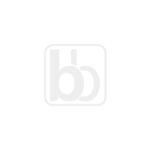


('Gourmet World Food', 'Groceries', 'Mango Kombucha - Zero Sugar', '330ml ', 150.0, 202216642, 'https://www.bigbasket.com/media/uploads/p/s/40213050_1-toyo-kombucha-mango-kombucha-zero-sugar.jpg', 4.2)
('Gourmet World Food', 'Groceries', 'Original Tonic Water - All Natural', '200 ml ', 85.0, 202216643, 'https://www.bigbasket.com/media/uploads/p/s/40184630_4-svami-original-tonic-water-all-natural.jpg', 4.9)
('Gourmet World Food', 'Groceries', 'Lemon Grass Kombucha - Zero Sugar', '330 ml ', 150.0, 202216644, 'https://www.bigbasket.com/media/uploads/p/s/40213049_1-toyo-kombucha-lemon-grass-kombucha-zero-sugar.jpg', 4.6)
('Gourmet World Food', 'Groceries', 'Original Kombucha - Zero Sugar', '330 ml ', 150.0, 202216645, 'https://www.bigbasket.com/media/uploads/p/s/40213044_1-toyo-kombucha-original-kombucha-zero-sugar.jpg', 4.5)
('Gourmet World Food', 'Groceries', 'Lemon Grass Kombucha', '330 ml ', 95.0, 202216646, 'https://www.bigbasket.com/media/uploads/p/s/40213042_1-toyo-kombucha-lemon-g

('Kitchen Garden Pets', 'Groceries', 'Steel Flat Bottom Tope/Patila/Bhagona - No. 14', '3.2 L ', 599.0, 202220104, 'https://www.bigbasket.com/media/uploads/p/s/40183423_8-bb-home-steel-flat-bottom-topepatilabhagona-no-14.jpg', 4.1)
('Kitchen Garden Pets', 'Groceries', 'Hard Anodised Cook & Serve Bowl - L62, 20 Cm', '2 L ', 1315.0, 202220105, 'https://www.bigbasket.com/media/uploads/p/s/40014077_4-hawkins-futura-hard-anodised-cook-serve-bowl-l62-20-cm.jpg', 4.9)
('Kitchen Garden Pets', 'Groceries', 'Steel Induction Bottom Tope/Patila/Bhagona - No. 13', '2.5 L ', 719.0, 202220106, 'https://www.bigbasket.com/media/uploads/p/s/40183426_10-bb-home-steel-induction-bottom-topepatilabhagona-no-13.jpg', 4.7)
('Kitchen Garden Pets', 'Groceries', 'Steel Flat Bottom Tope/Patila/Bhagona -  No. 12', '1.5 L ', 449.0, 202220107, 'https://www.bigbasket.com/media/uploads/p/s/40183422_8-bb-home-steel-flat-bottom-topepatilabhagona-no-12.jpg', 4.7)
('Kitchen Garden Pets', 'Groceries', 'Steel Induction Bott
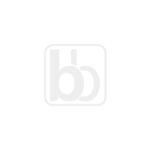

('Kitchen Garden Pets', 'Groceries', 'Anti Mosquito Racquet - Rechargeable Insect Killer Bat With LED Light', '1 pc (6 Months Warranty)', 549.0, 202223781, 'https://www.bigbasket.com/media/uploads/p/s/40174570_2-hit-anti-mosquito-racquet-rechargeable-insect-killer-bat-with-led-light.jpg', 4.1)
('Kitchen Garden Pets', 'Groceries', 'Energizer Lithium Coin Battery CR 2032', '1 pc ', 60.0, 202223782, 'https://www.bigbasket.com/media/uploads/p/s/40198109_2-energizer-energizer-lithium-coin-battery-cr-2032.jpg', 4.3)
('Kitchen Garden Pets', 'Groceries', 'LED T-Bulb - 18 Watt, Cool Daylight, B22', '1 pc ', 500.0, 202223783, 'https://www.bigbasket.com/media/uploads/p/s/40186905_1-philips-led-t-bulb-18-watt-cool-daylight-b22.jpg', 4.1)
('Kitchen Garden Pets', 'Groceries', 'LED Bulb - 5 Watt,  Cool Day Light, Base B22D', '1 pc ', 135.0, 202223784, 'https://www.bigbasket.com/media/uploads/p/s/40128545_5-eveready-led-bulb-5-watt-cool-day-light-base-b22d.jpg', 4.1)
('Kitchen Garden Pets', 'Groceries


('Bakery Cakes Dairy', 'Groceries', 'Almond Fingers', '250 g Pet Jar', 350.0, 202227521, 'https://www.bigbasket.com/media/uploads/p/s/40198878_2-cookie-man-almond-fingers.jpg', 4.0)
('Bakery Cakes Dairy', 'Groceries', 'French Heart', '200 g ', 115.0, 202227522, 'https://www.bigbasket.com/media/uploads/p/s/40120125_1-tasties-french-heart.jpg', 5.0)
('Bakery Cakes Dairy', 'Groceries', 'Traditional Butter Cookies - Cardamom, Crunchy', '150 g ', 129.0, 202227523, 'https://www.bigbasket.com/media/uploads/p/s/40055542_5-fresho-signature-traditional-butter-cookies-cardamom-crunchy.jpg', 4.1)
('Bakery Cakes Dairy', 'Groceries', 'Biscuits - Moon', '2x200 g Multipack ', 178.0, 202227524, 'https://www.bigbasket.com/media/uploads/p/s/1203309_1-tasties-biscuits-moon.jpg', 4.6)
('Bakery Cakes Dairy', 'Groceries', 'Dates Pudding Cake - Sliced', '150 g ', 50.0, 202227525, 'https://www.bigbasket.com/media/uploads/p/s/40204881_1-elite-dates-pudding-cake-sliced.jpg', 4.5)
('Bakery Cakes Dairy', 'Groceri

('Cleaning Household', 'Groceries', 'Harpic Disinfectant Toilet Cleaner Original200ml+Lizol Floor Cleaner Citrus200ml', 'Combo 2 Items', 76.0, 202213171, 'https://www.bigbasket.com/media/uploads/p/s/1204983_8-bb-combo-harpic-disinfectant-toilet-cleaner-original200mllizol-floor-cleaner-citrus200ml.jpg', 4.2)
('Cleaning Household', 'Groceries', 'Harpic Toilet Cleaner Liquid - Original 1 L + Lizol Floor Cleaner, Citrus - 2L', 'Combo (2 Items)', 567.0, 202213172, 'https://www.bigbasket.com/media/uploads/p/s/1208977_3-bb-combo-harpic-toilet-cleaner-liquid-original-1-l-lizol-floor-cleaner-citrus-2l.jpg', 4.2)
('Cleaning Household', 'Groceries', 'Super Saver Pack Toilet Cleaner Original, 500ml + Bathroom Cleaner Lemon, 500ml', 'Combo 2 Items', 184.0, 202213173, 'https://www.bigbasket.com/media/uploads/p/s/1200385_5-harpic-super-saver-pack-toilet-cleaner-original-500ml-bathroom-cleaner-lemon-500ml.jpg', 4.3)
('Cleaning Household', 'Groceries', 'Harpic Bathroom Cleaner - Lemon 1 L + Harpic Toil
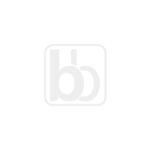

('Cleaning Household', 'Groceries', 'Notebook - Ruled, Long, Single Line, 76 Pages, Assorted', '1 pc ', 28.0, 202216252, 'https://www.bigbasket.com/media/uploads/p/s/40220816_2-sundaram-notebook-ruled-long-single-line-76-pages-assorted.jpg', 4.2)
('Cleaning Household', 'Groceries', 'Youva - Brown Soft Bound Notebook, Single Line, 18 cmx24 cm', '76 Pages ', 25.0, 202216253, 'https://www.bigbasket.com/media/uploads/p/s/40219503_1-navneet-youva-brown-soft-bound-notebook-single-line-18-cmx24-cm.jpg', 4.6)
('Cleaning Household', 'Groceries', 'Note Book - Single Line, 76 Pages, 18 x 24 cm', '1 pc ', 25.0, 202216254, 'https://www.bigbasket.com/media/uploads/p/s/40220836_2-sundaram-note-book-single-line-76-pages-18-x-24-cm.jpg', 4.4)
('Cleaning Household', 'Groceries', 'Notebook - A4, Long, Single Line, 76 Pages, Assorted', '1 pc ', 35.0, 202216255, 'https://www.bigbasket.com/media/uploads/p/s/40220818_2-sundaram-notebook-a4-long-single-line-76-pages-assorted.jpg', 4.9)
('Cleaning Household', 

('Cleaning Household', 'Groceries', 'Disinfectant Surface & Floor Cleaner Liquid - [Citrus 2 L + Floral 2 L]', 'Combo 2 Items', 760.0, 202219153, 'https://www.bigbasket.com/media/uploads/p/s/1202437_7-lizol-disinfectant-surface-floor-cleaner-liquid-citrus-2-l-floral-2-l.jpg', 4.5)
('Cleaning Household', 'Groceries', 'Disinfectant Surface & Floor Cleaner Liquid - [Citrus 975 ml + Lavender 975 ml]|', 'Combo 2 Items', 376.0, 202219154, 'https://www.bigbasket.com/media/uploads/p/s/1200282_4-lizol-disinfectant-surface-floor-cleaner-liquid-citrus-975-ml-lavender-975-ml.jpg', 4.1)
('Cleaning Household', 'Groceries', 'Disinfectant Surface & Floor Cleaner Liquid - [Citrus 2 L + Lavender 2 L]', 'Combo 2 Items', 760.0, 202219155, 'https://www.bigbasket.com/media/uploads/p/s/1202438_7-lizol-disinfectant-surface-floor-cleaner-liquid-citrus-2-l-lavender-2-l.jpg', 4.5)
('Cleaning Household', 'Groceries', 'Disinfectant Surface & Floor Cleaner Liquid - Floral, Kills 99.9% Germs', '2 L  ', 380.0, 202219
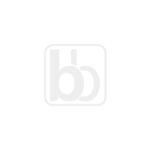

('Foodgrains Oil Masala', 'Groceries', 'Superior Classic Basmati Rice', '2x1 kg Multipack ', 410.0, 202221944, 'https://www.bigbasket.com/media/uploads/p/s/1212740_2-bb-royal-superior-classic-basmati-rice.jpg', 4.6)
('Foodgrains Oil Masala', 'Groceries', 'Brown Basmati Rice', '2x1 Kg Multipack ', 292.0, 202221945, 'https://www.bigbasket.com/media/uploads/p/s/1212741_2-bb-royal-brown-basmati-rice.jpg', 4.1)
('Foodgrains Oil Masala', 'Groceries', 'Biryani Basmati Rice/Basmati Akki Kit - Authentic Hyderabadi', '327 g (Ready to Cook)', 149.0, 202221946, 'https://www.bigbasket.com/media/uploads/p/s/40135884_6-kohinoor-biryani-basmati-rice-kit-authentic-hyderabadi.jpg', 4.7)
('Foodgrains Oil Masala', 'Groceries', 'Basmati Rice/Basmati Akki - Authentic, Super Value', '5 kg  ', 810.0, 202221947, 'https://www.bigbasket.com/media/uploads/p/s/40073397_5-kohinoor-basmati-rice-authentic-super-value.jpg', 4.3)
('Foodgrains Oil Masala', 'Groceries', 'Rice - Basmati, 1121 Dubar', '2x1 kg Multipack ', 

('Snacks Branded Foods', 'Groceries', 'Namkeen - Tasty Nuts', '200 g Pouch ', 48.0, 202224378, 'https://www.bigbasket.com/media/uploads/p/s/20002444_1-haldirams-namkeen-tasty-nuts.jpg', 4.9)
('Snacks Branded Foods', 'Groceries', 'Namkeen - Butter Murukku', '30 g  ', 10.0, 202224379, 'https://www.bigbasket.com/media/uploads/p/s/40123663_2-townbus-namkeen-butter-murukku.jpg', 4.9)
('Snacks Branded Foods', 'Groceries', 'Peanut - Salted', '3x150 g Multipack ', 141.0, 202224380, 'https://www.bigbasket.com/media/uploads/p/s/1203957_1-haldirams-peanut-salted.jpg', 4.1)
('Snacks Branded Foods', 'Groceries', 'Namkeen - Masala Peanut', '6x50 g Multipack ', 60.0, 202224381, 'https://www.bigbasket.com/media/uploads/p/s/1203933_1-haldirams-namkeen-masala-peanut.jpg', 4.2)
('Snacks Branded Foods', 'Groceries', 'Soya Sticks', '200 g Pouch', 45.0, 202224382, 'https://www.bigbasket.com/media/uploads/p/s/20004451_2-haldirams-soya-sticks.jpg', 5.0)
('Snacks Branded Foods', 'Groceries', 'Namkeen - Ribbon 

('Kitchen Garden Pets', 'Groceries', 'Laopala Opalware Dinner Set WL Lush Greens', '23 pcs ', 2395.0, 202227144, 'https://www.bigbasket.com/media/uploads/p/s/40175082_5-laopala-laopala-opalware-dinner-set-wl-lush-greens.jpg', 4.5)
('Kitchen Garden Pets', 'Groceries', 'Scarlett Bliss Dinner Set - White', '20 pcs ', 2045.0, 202227145, 'https://www.bigbasket.com/media/uploads/p/s/40199621_7-cello-scarlett-bliss-dinner-set-white.jpg', 4.3)
('Kitchen Garden Pets', 'Groceries', 'Opalware Dazzle Dinner Set - Scarlet Bliss', '18 pcs ', 1895.0, 202227146, 'https://www.bigbasket.com/media/uploads/p/s/40156109_5-cello-opalware-dazzle-dinner-set-scarlet-bliss.jpg', 4.6)
('Kitchen Garden Pets', 'Groceries', 'Dazzle Livid Lilac Dinner Set - White', '18 pcs ', 1895.0, 202227147, 'https://www.bigbasket.com/media/uploads/p/s/40199610_5-cello-dazzle-livid-lilac-dinner-set-white.jpg', 4.3)
('Kitchen Garden Pets', 'Groceries', '100% Melamine Dinner Set - Red', '8 pcs ', 902.0, 202227148, 'https://www.bigb


('Snacks Branded Foods', 'Groceries', 'Cooking Paste - Hyderabadi Biryani, Ready To Cook Indian Paste, No Preservatives', '80 g  ', 75.0, 202212022, 'https://www.bigbasket.com/media/uploads/p/s/40200610_2-itc-master-chef-cooking-paste-hyderabadi-biryani-ready-to-cook-indian-paste-no-preservatives.jpg', 4.3)
('Snacks Branded Foods', 'Groceries', 'Thai Red Curry Kit', '255 g ', 225.0, 202212023, 'https://www.bigbasket.com/media/uploads/p/s/40214336_2-happychef-thai-red-curry-kit.jpg', 4.4)
('Snacks Branded Foods', 'Groceries', 'Ready To Eat - Jeera Rice', '250 g Carton', 99.0, 202212024, 'https://www.bigbasket.com/media/uploads/p/s/40001479_6-mtr-ready-to-eat-jeera-rice.jpg', 4.5)
('Snacks Branded Foods', 'Groceries', 'Ready To Eat - Chicken Darbari', '285 g ', 200.0, 202212025, 'https://www.bigbasket.com/media/uploads/p/s/40001332_2-kitchens-of-india-ready-to-eat-chicken-darbari.jpg', 4.7)
('Snacks Branded Foods', 'Groceries', 'Ready to Eat - Pindi Chana', '285 g Carton', 110.0, 202212
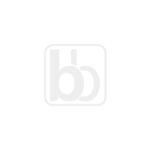

('Foodgrains Oil Masala', 'Dry Fruits', 'Figs/Anjeer 100G + Dry Dates 100G + Pista Kernel Plain 100G + Dry Apricots 100G', 'Combo 4 Items', 780.0, 202214554, 'https://www.bigbasket.com/media/uploads/p/s/1206892_1-bb-royal-figsanjeer-100g-dry-dates-100g-pista-kernel-plain-100g-dry-apricots-100g.jpg', 4.5)
('Foodgrains Oil Masala', 'Dry Fruits', 'Dates/Kharjura', '500 g Pouch ', 89.0, 202214555, 'https://www.bigbasket.com/media/uploads/p/s/163578_3-lion-lion-dates.jpg', 4.8)
('Foodgrains Oil Masala', 'Dry Fruits', 'Dry Dates/Kharjura - Chuwara, Kharik', '500 g Pouch', 400.0, 202214556, 'https://www.bigbasket.com/media/uploads/p/s/40018889_4-bb-royal-dry-dates-chuwara-kharik.jpg', 4.0)
('Foodgrains Oil Masala', 'Dry Fruits', 'Hazelnut', '100 g Pouch ', 250.0, 202214557, 'https://www.bigbasket.com/media/uploads/p/s/10000517_4-bb-royal-hazelnut.jpg', 4.6)
('Foodgrains Oil Masala', 'Dry Fruits', 'Chironji', '100 g  ', 200.0, 202214558, 'https://www.bigbasket.com/media/uploads/p/s/40053920_2-

('Foodgrains Oil Masala', 'Groceries', 'Jowar Whole', '2 kg ', 180.0, 202217451, 'https://www.bigbasket.com/media/uploads/p/s/40053936_5-bb-royal-jowar-whole.jpg', 4.5)
('Foodgrains Oil Masala', 'Groceries', 'Wheat Sharbati', '1 kg ', 59.0, 202217452, 'https://www.bigbasket.com/media/uploads/p/s/40160749_3-safe-harvest-wheat-sharbati.jpg', 4.0)
('Foodgrains Oil Masala', 'Groceries', 'Thick Poha', '1 kg ', 65.0, 202217453, 'https://www.bigbasket.com/media/uploads/p/s/40216186_1-vijay-thick-poha.jpg', 4.8)
('Foodgrains Oil Masala', 'Groceries', 'Corn Poha, Unpolish', '500 g ', 70.0, 202217454, 'https://www.bigbasket.com/media/uploads/p/s/40088526_3-bb-royal-corn-poha-unpolish.jpg', 4.4)
('Foodgrains Oil Masala', 'Groceries', 'Aval/Poha - Red Thick', '500 g ', 45.0, 202217455, 'https://www.bigbasket.com/media/uploads/p/s/40160073_4-super-saver-avalpoha-red-thick.jpg', 4.9)
('Foodgrains Oil Masala', 'Groceries', 'Kohinoor Chatpata MultiUse Seasoning 12 g + Tata Sampann White Poha - Thin 50


('Foodgrains Oil Masala', 'Groceries', 'Organic Sprouted Ragi Powder/Ragi Hittu', '250 g ', 300.0, 202219234, 'https://www.bigbasket.com/media/uploads/p/s/40185321_3-slurrp-farm-organic-sprouted-ragi-powder.jpg', 4.1)
('Foodgrains Oil Masala', 'Groceries', 'Ragi Flour/Ragi Hittu - Pesticide Free', '1 kg ', 99.0, 202219235, 'https://www.bigbasket.com/media/uploads/p/s/40144598_3-safe-harvest-ragi-flour-pesticide-free.jpg', 4.5)
('Foodgrains Oil Masala', 'Groceries', 'Idiappam Podi', '500 g ', 57.0, 202219236, 'https://www.bigbasket.com/media/uploads/p/s/40128145_1-eastern-idiappam-podi.jpg', 4.7)
('Foodgrains Oil Masala', 'Groceries', 'Jowar Atta - Pesticide Free', '500 g ', 59.0, 202219237, 'https://www.bigbasket.com/media/uploads/p/s/40144588_3-safe-harvest-jowar-atta-pesticide-free.jpg', 4.6)
('Foodgrains Oil Masala', 'Groceries', 'Sona Masuri - Unpolished Rice/Akki', '5 Kg ', 520.0, 202219238, 'https://www.bigbasket.com/media/uploads/p/s/40198175_2-himalayan-natives-sona-masuri-unp
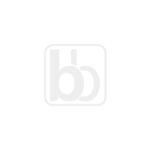

('Kitchen Garden Pets', 'Groceries', 'Vapo Rub - With Menthol, Camphor & Eucalyptus Oil, Provides Relief From Cold', '50 ml Bottle ', 145.0, 202221671, 'https://www.bigbasket.com/media/uploads/p/s/263850_4-vicks-vapo-rub-with-menthol-camphor-eucalyptus-oil-provides-relief-from-cold.jpg', 4.4)
('Kitchen Garden Pets', 'Groceries', 'Cough Drops - Ginger', '2 g Pack of 20 ', 20.0, 202221672, 'https://www.bigbasket.com/media/uploads/p/s/40120611_3-vicks-cough-drops-ginger.jpg', 4.7)
('Kitchen Garden Pets', 'Groceries', 'N95 Face Mask - White', '2 pcs ', 199.0, 202221673, 'https://www.bigbasket.com/media/uploads/p/s/40219081_1-shamrock-n95-face-mask-white.jpg', 4.8)
('Kitchen Garden Pets', 'Groceries', 'Washable Face Mask - 3 Layer Protection, Reversible', '24cm x 12 cm (Pack of 3)', 239.0, 202221674, 'https://www.bigbasket.com/media/uploads/p/s/40197846_2-fairkraft-creations-washable-face-mask-3-layer-protection-reversible.jpg', 4.5)
('Kitchen Garden Pets', 'Groceries', 'Chyawanprash - 2X I

('Beverages', 'Groceries', 'Vanilla Matcha Green Tea Powder - Japan Origin, Unique Taste', '50 g ', 499.0, 202224658, 'https://www.bigbasket.com/media/uploads/p/s/40177407_1-vahdam-vanilla-matcha-green-tea-powder-japan-origin-unique-taste.jpg', 4.0)
('Beverages', 'Groceries', 'Slim Detox Tea - For Weight-Loss, Boosts Health', '150 g ', 300.0, 202224659, 'https://www.bigbasket.com/media/uploads/p/s/40199432_2-jiva-ayurveda-slim-detox-tea-for-weight-loss-boosts-health.jpg', 4.9)
('Beverages', 'Groceries', 'Nilgiri Green Tea - Seiki Peppermint', '125 g  ', 550.0, 202224660, 'https://www.bigbasket.com/media/uploads/p/s/40187583_1-teamonk-nilgiri-green-tea-seiki-peppermint.jpg', 4.1)
('Beverages', 'Groceries', 'Organic Honey Lemon Green Tea Bags - Refreshing Vitamin C Infused Tea', '30 g (15 Pyramid Bags x 2 g each)', 225.0, 202224661, 'https://www.bigbasket.com/media/uploads/p/s/40207938_1-vahdam-organic-honey-lemon-green-tea-bags-refreshing-vitamin-c-infused-tea.jpg', 4.8)
('Beverages', '

('Beauty Hygiene', 'Groceries', 'Cocoa Butter Intensive Body Lotion', '3x400 ml Multipack ', 840.0, 202227281, 'https://www.bigbasket.com/media/uploads/p/s/1212190_1-himalaya-cocoa-butter-intensive-body-lotion.jpg', 4.4)
('Beauty Hygiene', 'Groceries', 'Deep Nourish Body Lotion', '2x400 ml (Multipack) ', 620.0, 202227282, 'https://www.bigbasket.com/media/uploads/p/s/1208528_4-parachute-advansed-deep-nourish-body-lotion.jpg', 4.5)
('Beauty Hygiene', 'Groceries', 'Extra Moisturizing Body Lotion - With Bee Wax, Coconut & Almond Oil', '250 ml ', 499.0, 202227283, 'https://www.bigbasket.com/media/uploads/p/s/40218821_1-nutrinorm-extra-moisturizing-body-lotion-with-bee-wax-coconut-almond-oil.jpg', 4.0)
('Beauty Hygiene', 'Groceries', 'Pure Aloe Repairing & Soothing Aloe Vera Gel - For Face & Body', '300 ml ', 249.0, 202227284, 'https://www.bigbasket.com/media/uploads/p/s/40213208_1-joy-pure-aloe-repairing-soothing-aloe-vera-gel-for-face-body.jpg', 4.8)
('Beauty Hygiene', 'Groceries', 'Vitami

('Gourmet World Food', 'Groceries', 'Potato Chips - Rock Sea Salt & English Vinegar', '125 g ', 99.0, 202212192, 'https://www.bigbasket.com/media/uploads/p/s/40096803_2-kettle-studio-potato-chips-rock-sea-salt-english-vinegar.jpg', 4.6)
('Gourmet World Food', 'Groceries', 'Nacho Crisps - Sizzlin Jalapeno', '3 x 30 g Multipack ', 60.0, 202212193, 'https://www.bigbasket.com/media/uploads/p/s/1213159_1-cornitos-nacho-crisps-sizzlin-jalapeno.jpg', 4.7)
('Gourmet World Food', 'Groceries', 'Chatpata Pudina Naan Chips', '2 x 60 g Multipack ', 80.0, 202212194, 'https://www.bigbasket.com/media/uploads/p/s/1214047_1-wingreens-farms-chatpata-pudina-naan-chips.jpg', 4.7)
('Gourmet World Food', 'Groceries', 'Nacho Chips - Melange', '70 g ', 50.0, 202212195, 'https://www.bigbasket.com/media/uploads/p/s/40126901_4-cornitos-nacho-chips-melange.jpg', 4.4)
('Gourmet World Food', 'Groceries', 'Crunchy Soya Chips', '100 g ', 99.0, 202212196, 'https://www.bigbasket.com/media/uploads/p/s/40147722_1-graminwa


('Bakery Cakes Dairy', 'Groceries', 'Baguette Bread - Multigrain', '300 g ', 65.0, 202213511, 'https://www.bigbasket.com/media/uploads/p/s/40037468_6-fresho-signature-baguette-bread-multigrain.jpg', 4.9)
('Bakery Cakes Dairy', 'Groceries', 'Baguette - 100% Wholewheat Sourdough', '150 g ', 85.0, 202213512, 'https://www.bigbasket.com/media/uploads/p/s/40169937_2-the-bakers-dozen-baguette-100-wholewheat-sourdough.jpg', 4.9)
('Bakery Cakes Dairy', 'Groceries', 'Critters - Whole Wheat', '150 g ', 40.0, 202213513, 'https://www.bigbasket.com/media/uploads/p/s/40111541_2-milk-ma-critters-whole-wheat.jpg', 4.8)
('Foodgrains Oil Masala', 'Groceries', 'Organic - Toor Dal/Togari Bele', '2 kg  ', 399.0, 202213514, 'https://www.bigbasket.com/media/uploads/p/s/40075469_9-bb-royal-organic-turtoor-dal.jpg', 4.9)
('Foodgrains Oil Masala', 'Groceries', 'Organic - Almond/Badam', '100 g  ', 195.0, 202213515, 'https://www.bigbasket.com/media/uploads/p/s/40072510_14-bb-royal-organic-almondbadam.jpg', 5.0)
(
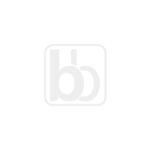


('Foodgrains Oil Masala', 'Dry Fruits', 'Almond/Badam Californian 100g + Indian Raisins 100g + Cashew W 320 100g', 'Combo 3 Items', 350.0, 202215757, 'https://www.bigbasket.com/media/uploads/p/s/1202077_1-bb-popular-almondbadam-californian-100g-indian-raisins-100g-cashew-w-320-100g.jpg', 4.1)
('Foodgrains Oil Masala', 'Dry Fruits', 'Almonds - Oven Roasted & Salted, Premium Californian', '2x200 g Multipack ', 790.0, 202215758, 'https://www.bigbasket.com/media/uploads/p/s/1204210_1-happilo-almonds-oven-roasted-salted-premium-californian.jpg', 4.3)
('Foodgrains Oil Masala', 'Dry Fruits', 'Almond/Badam Californian 500g + Cashew/Kaju Whole 500g', 'Combo 2 Items', 1900.0, 202215759, 'https://www.bigbasket.com/media/uploads/p/s/1202071_1-bb-royal-almondbadam-californian-500g-cashewkaju-whole-500g.jpg', 4.5)
('Foodgrains Oil Masala', 'Dry Fruits', '100% Natural - Californian Almonds', '200 g  ', 355.0, 202215760, 'https://www.bigbasket.com/media/uploads/p/s/40087191_4-happilo-100-natural-cali

('Foodgrains Oil Masala', 'Groceries', 'Podi - Puttu', '500 g Pouch', 56.0, 202219218, 'https://www.bigbasket.com/media/uploads/p/s/40001238_4-eastern-podi-puttu.jpg', 4.4)
('Foodgrains Oil Masala', 'Groceries', "Nature's Super Foods - Gluten Free Flour", '1 kg Pouch', 190.0, 202219219, 'https://www.bigbasket.com/media/uploads/p/s/40172984_3-aashirvaad-natures-super-foods-gluten-free-flour.jpg', 4.6)
('Foodgrains Oil Masala', 'Groceries', 'Chilla Mix - Moong Dal/Hesaru Bele', '180 g ', 70.0, 202219220, 'https://www.bigbasket.com/media/uploads/p/s/40125389_5-tata-sampann-protein-rich-moong-dal-chilla-mix.jpg', 4.1)
('Foodgrains Oil Masala', 'Groceries', 'Ragi Dosa Mix', '500 g Pouch', 110.0, 202219221, 'https://www.bigbasket.com/media/uploads/p/s/266272_3-indiras-ragi-dosa-mix.jpg', 4.6)
('Foodgrains Oil Masala', 'Groceries', 'Rice Flour/Akki Hittu', '500 g Pouch', 43.0, 202219222, 'https://www.bigbasket.com/media/uploads/p/s/40001252_3-manna-rice-flour.jpg', 4.6)
('Foodgrains Oil Masal
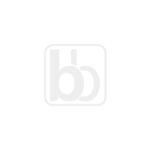

('Bakery Cakes Dairy', 'Groceries', 'Goodlife - Toned Milk', '500 ml Pack of 20', 520.0, 202221077, 'https://www.bigbasket.com/media/uploads/p/s/244999_1-nandini-goodlife-toned-milk.jpg', 4.8)
('Bakery Cakes Dairy', 'Groceries', 'Homogenised Toned Milk', '1 L Carton ', 66.0, 202221078, 'https://www.bigbasket.com/media/uploads/p/s/306926_4-amul-homogenised-toned-milk.jpg', 4.2)
('Bakery Cakes Dairy', 'Groceries', 'Fresh Toned Milk', '500 ml Carton ', 34.0, 202221079, 'https://www.bigbasket.com/media/uploads/p/s/40041431_1-amul-fresh-toned-milk.jpg', 4.7)
('Bakery Cakes Dairy', 'Groceries', 'Slim - Skimmed Milk', '500 ml Pouch ', 25.0, 202221080, 'https://www.bigbasket.com/media/uploads/p/s/242673_1-nandini-slim-skimmed-milk.jpg', 4.6)
('Bakery Cakes Dairy', 'Groceries', 'Homogenised Standardised Milk', '6x1 L Multipack ', 420.0, 202221081, 'https://www.bigbasket.com/media/uploads/p/s/1202686_1-amul-gold-homogenised-standardised-milk.jpg', 4.8)
('Bakery Cakes Dairy', 'Groceries', 'Lactos


('Snacks Branded Foods', 'Groceries', '100% Pure Honey, 1 kg + Oats, 1 kg', 'Combo 2 Items', 585.0, 202223725, 'https://www.bigbasket.com/media/uploads/p/s/1214177_1-bb-royal-100-pure-honey-1-kg-oats-1-kg.jpg', 5.0)
('Snacks Branded Foods', 'Groceries', '100% Pure Honey, 1 kg + Corn Flakes Classic, 475 g', 'Combo 2 Items', 575.0, 202223726, 'https://www.bigbasket.com/media/uploads/p/s/1214178_1-bb-royal-100-pure-honey-1-kg-corn-flakes-classic-475-g.jpg', 4.8)
('Snacks Branded Foods', 'Groceries', '100% Pure Honey, 250 g + Corn Flakes Classic, 475 g', 'Combo 2 Items', 279.0, 202223727, 'https://www.bigbasket.com/media/uploads/p/s/1214759_1-bb-royal-100-pure-honey-250-g-corn-flakes-classic-475-g.jpg', 4.5)
('Snacks Branded Foods', 'Groceries', '100% Pure Honey - Worlds No.1 Honey Brand With No Sugar Adulteration', '100 g Bottle ', 62.0, 202223728, 'https://www.bigbasket.com/media/uploads/p/s/239524_6-dabur-100-pure-honey-worlds-no1-honey-brand-with-no-sugar-adulteration.jpg', 4.6)
('Sna

('Snacks Branded Foods', 'Groceries', 'Chutney Podi', '100 g ', 50.0, 202225831, 'https://www.bigbasket.com/media/uploads/p/s/40103763_2-farmveda-chutney-podi.jpg', 4.3)
('Snacks Branded Foods', 'Groceries', 'Pop Assorted Flavours Lollipop', '5 pcs Pouch', 30.0, 202225832, 'https://www.bigbasket.com/media/uploads/p/s/40094202_21-alpenliebe-pop-assorted-flavours-lollipop.jpg', 4.6)
('Snacks Branded Foods', 'Groceries', 'Sour Bites Mixed Fruit Flavour Soft & Chewy Toffee', '61.6 g  ', 30.0, 202225833, 'https://www.bigbasket.com/media/uploads/p/s/40094214_10-chupa-chups-sour-bites-mixed-fruit-flavour-soft-chewy-toffee.jpg', 4.4)
('Snacks Branded Foods', 'Groceries', 'Candy - Melody Chocolaty', '195.5 g Pouch ', 50.0, 202225834, 'https://www.bigbasket.com/media/uploads/p/s/270030_1-parle-candy-melody-chocolaty.jpg', 4.6)
('Snacks Branded Foods', 'Groceries', 'Polo - The Mint With The Hole', '15 g Pouch', 5.0, 202225835, 'https://www.bigbasket.com/media/uploads/p/s/118555_11-nestle-polo-the


('Gourmet World Food', 'Groceries', 'Extra Virgin Olive Oil', '1 L Plastic Bottle ', 1600.0, 202228588, 'https://www.bigbasket.com/media/uploads/p/s/40041182_4-del-monte-extra-virgin-olive-oil.jpg', 4.2)
('Gourmet World Food', 'Groceries', 'Cold Pressed Kachi Ghani Mustard Cooking Oil', '1 L Spout Pack', 350.0, 202228589, 'https://www.bigbasket.com/media/uploads/p/s/40181475_9-bb-royal-organic-cold-pressed-kachi-ghani-mustard-cooking-oil.jpg', 4.5)
('Snacks Branded Foods', 'Groceries', 'Muesli Breakfast Cereal - With Multigrain & 21% Fruit, Nut & Seeds', '750 g 0 ', 430.0, 202228590, 'https://www.bigbasket.com/media/uploads/p/s/40189244_4-kelloggs-muesli-breakfast-cereal-with-multigrain-21-fruit-nut-seeds.jpg', 4.6)
('Snacks Branded Foods', 'Groceries', 'Muesli With 20% Nuts Delight', '750 g Pouch ', 415.0, 202228591, 'https://www.bigbasket.com/media/uploads/p/s/40189241_2-kelloggs-muesli-with-20-nuts-delight.jpg', 4.6)
('Snacks Branded Foods', 'Groceries', 'Muesli With 21% Fruit & Nu

In [36]:
import pandas as pd
import sqlite3

conn = sqlite3.connect('../../data_preprocessing.db') 
c = conn.cursor()

inventory_df.to_sql('PreprocessedData', conn, if_exists='append', index=False)

conn.commit();

c.execute('''  
SELECT * FROM PreprocessedData
          ''')

for row in c.fetchall():
    print (row)

c.close()
    
conn.close()